In [ ]:
import os
os.environ["KERAS_BACKEND"] = "tensorflow"
import sys
import tensorflow as tf
import keras
from keras import layers
from keras import ops
import pandas as pd
import numpy as np
import cv2
import matplotlib.pyplot as plt
keras.utils.set_random_seed(123)

In [ ]:
annotation_folder = "/kaggle/working/dataset/" 
if not os.path.exists(os.path.abspath(".") + annotation_folder):
    annotation_zip = keras.utils.get_file(
        "val.tar.gz",
        cache_subdir=os.path.abspath(annotation_folder),  # Extract to /kaggle/working/dataset/
        origin="http://diode-dataset.s3.amazonaws.com/val.tar.gz",
        extract=True,
    )

In [ ]:
df_list = [] # To Store Both Indoor and Outdoor
for scene_type in ["indoors", "outdoor"]:
    path = os.path.join("/kaggle/working/dataset/val", scene_type)
    filelist = []
    for root, dirs, files in os.walk(path):
        for file in files:
            filelist.append(os.path.join(root, file))
    filelist.sort()
    data = {
        "image": [x for x in filelist if x.endswith(".png")],
        "depth": [x for x in filelist if x.endswith("_depth.npy")],
        "mask": [x for x in filelist if x.endswith("_depth_mask.npy")],
    }
    df = pd.DataFrame(data) 
    df = df.sample(frac=1, random_state=42)
    df_list.append(df)  # Append the dataframe to the list
# Concatenate the dataframes
df = pd.concat(df_list, ignore_index=True)
#Check if Paths are correct
print(df.iloc[0]['image'])
print(df.iloc[0]['depth'])
print(df.iloc[0]['mask'])

In [ ]:
def load_and_preprocess_data(df_row, img_size=(256, 256)):
    """
    Loads and preprocesses image and depth map from a DataFrame row
    """
    img_path = df_row['image']
    depth_path = df_row['depth']
    mask_path = df_row['mask']
    
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, img_size)
    img = tf.image.convert_image_dtype(img, tf.float32) # Use tf.image.convert_image_dtype
    depth_map = np.load(depth_path).squeeze()
    mask = np.load(mask_path)
    mask = mask > 0
    max_depth = min(300, np.percentile(depth_map, 99))
    depth_map = np.clip(depth_map, 0.1, max_depth)
    depth_map = np.log(depth_map, where=mask)
    print("Min/Max depth before preprocessing:", np.min(depth_map), np.max(depth_map))
    depth_map = np.ma.masked_where(~mask, depth_map)
    depth_map = np.clip(depth_map, 0.1, np.log(max_depth))# Clip after masking
    depth_map = cv2.resize(depth_map, img_size)
    depth_map = np.expand_dims(depth_map, axis=-1)
    depth_map = tf.image.convert_image_dtype(depth_map, tf.float32) 
    print("Min/Max depth after preprocessing:", np.min(depth_map), np.max(depth_map))# Use tf.image.convert_image_dtype
    return img, depth_map

In [ ]:
import matplotlib.pyplot as plt
def visualize_data(image, depth_map, mask):
    """
    Visualizes the image and its corresponding depth map with mask applied.
    """
    # Apply mask to depth map
    masked_depth = depth_map * mask
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    axes[0].imshow(image)
    axes[0].set_title('Image')
    
    # Use plt.cm.jet colormap
    axes[1].imshow(depth_map, cmap=plt.cm.jet)  
    axes[1].set_title('Raw Depth Map')
    
    # Use plt.cm.jet colormap
    axes[2].imshow(masked_depth, cmap=plt.cm.jet) 
    axes[2].set_title('Masked Depth Map')
    plt.savefig("visualization_example.jpg")
    plt.show()
# Example usage 
for i in range(3):
    img, depth_map = load_and_preprocess_data(df.iloc[i]) 
    # Load the mask
    mask_path = df.iloc[i]['mask']
    mask = np.load(mask_path)
    mask = cv2.resize(mask, (img.shape[1], img.shape[0]))  # Resize mask to match image
    mask = np.expand_dims(mask, axis=-1)  # Add channel dimension
    visualize_data(img, depth_map, mask)

In [ ]:
def create_depth_estimation_model(input_shape=(256, 256, 3)):
    """
    Creates a depth estimation model with ResNet50 encoder and U-Net decoder.
    """
    # Encoder 
    inputs = Input(shape=input_shape)
    base_model = ResNet50(weights='imagenet', include_top=False, input_tensor=inputs)
    # Get feature maps from encoder
    skip_connections = [
        base_model.get_layer("conv1_relu").output,        # (None, 128, 128, 64)
        base_model.get_layer("conv2_block3_out").output,  # (None, 64, 64, 256)
        base_model.get_layer("conv3_block4_out").output,  # (None, 32, 32, 512)
        base_model.get_layer("conv4_block6_out").output,  # (None, 16, 16, 1024)
    ]
    # Decoder
    up1 = UpSampling2D(size=(2, 2))(base_model.output)   # (None, 32, 32, 2048)
    concat1 = concatenate([up1, skip_connections[3]], axis=-1)  # (None, 32, 32, 3072)
    conv1 = Conv2D(1024, 3, activation='relu', padding='same')(concat1)
    conv1 = Conv2D(1024, 3, activation='relu', padding='same')(conv1)
    up2 = UpSampling2D(size=(2, 2))(conv1)   # (None, 64, 64, 1024)
    concat2 = concatenate([up2, skip_connections[2]], axis=-1)  # (None, 64, 64, 1536)
    conv2 = Conv2D(512, 3, activation='relu', padding='same')(concat2)
    conv2 = Conv2D(512, 3, activation='relu', padding='same')(conv2)
    up3 = UpSampling2D(size=(2, 2))(conv2)   # (None, 128, 128, 512)
    concat3 = concatenate([up3, skip_connections[1]], axis=-1)  # (None, 128, 128, 768)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(concat3)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    up4 = UpSampling2D(size=(2, 2))(conv3)   # (None, 256, 256, 256)
    concat4 = concatenate([up4, skip_connections[0]], axis=-1)  # (None, 256, 256, 320)
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(concat4)
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)
    up5 = UpSampling2D(size=(2, 2))(conv4)   # (None, 512, 512, 128)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(up5)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5) 
    # Output layer
    output = Conv2D(1, 1, activation='linear')(conv5)  # or 'sigmoid'
    model = Model(inputs=inputs, outputs=output)
    return model

In [ ]:
# from tensorflow.keras import backend as K
# def custom_loss(y_true, y_pred):
#     mse_loss = K.mean(K.square(y_true - y_pred))
#     huber_loss = tf.keras.losses.huber(y_true, y_pred)
    
#     # Combine the losses
#     total_loss = mse_loss + 0.1 * huber_loss  
#     return total_loss

In [ ]:
import tensorflow as tf
from tensorflow.keras.losses import MeanAbsoluteError

def ssim_loss(y_true, y_pred):
    """Computes SSIM loss between predicted and ground truth depth maps."""
    return 1 - tf.reduce_mean(tf.image.ssim(y_true, y_pred, max_val=1.0))

def combined_loss(y_true, y_pred, alpha=0.85, beta=0.15):
    """Combines SSIM and L1 loss."""
    ssim = ssim_loss(y_true, y_pred)
    l1 = MeanAbsoluteError()(y_true, y_pred)
    return alpha * ssim + beta * l1

In [ ]:
from sklearn.model_selection import train_test_split
import tensorflow_addons as tfa

images = []
depth_maps = []
for index, row in df.iterrows():
    img, depth_map = load_and_preprocess_data(row)
    images.append(img)
    depth_maps.append(depth_map)
images = np.array(images)
depth_maps = np.array(depth_maps)
X_train, X_val, y_train, y_val = train_test_split(
    images, depth_maps, test_size=0.2, random_state=42
)

In [ ]:
from tensorflow.keras.layers import Input
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.layers import UpSampling2D, concatenate, Conv2D
from tensorflow.keras.models import Model


with tf.device('/GPU:0'):
    model = create_depth_estimation_model()
    model.compile(optimizer='adam', loss=combined_loss, metrics=['mae'])
    history = model.fit(
        X_train,
        y_train,
        epochs=60,
        batch_size=16,
        validation_data=(X_val, y_val),
        shuffle=True
    )

In [29]:
import cv2
import tensorflow as tf

def load_and_preprocess_image(image_path, img_size=(256, 256)):
    """Loads and preprocesses a single image."""
    img = cv2.imread(image_path)
    
    if img is None:
        raise FileNotFoundError(f"Image not found: {image_path}")
    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, img_size)
    img = tf.image.convert_image_dtype(img, tf.float32)
    return img

new_image = load_and_preprocess_image("/kaggle/input/hxyrztez/00012_00112_outdoor_000_020.png")


In [30]:
import numpy as np

new_image = np.array(new_image)  # Convert to NumPy array
predicted_depth = model.predict(np.expand_dims(new_image, axis=0))


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step


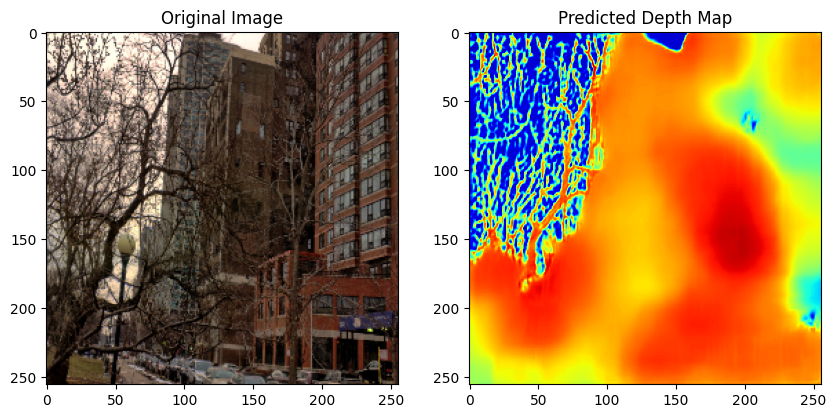

In [31]:
import matplotlib.pyplot as plt
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.imshow(new_image)
plt.title("Original Image")
plt.subplot(1, 2, 2)
plt.imshow(predicted_depth[0, :, :, 0], cmap=plt.cm.jet) 
plt.title("Predicted Depth Map")
plt.show()

In [ ]:
# import tensorflow as tf
# from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, Dense, Multiply, Add, Conv2D, Reshape, Input, UpSampling2D, concatenate, Lambda
# from tensorflow.keras.models import Model
# from tensorflow.keras.applications import ResNet50

# def channel_attention(input_feature, ratio=8):
#     """CBAM Channel Attention Mechanism."""
#     channel = input_feature.shape[-1]
    
#     # Global Average Pooling & Global Max Pooling
#     avg_pool = GlobalAveragePooling2D(keepdims=True)(input_feature)
#     max_pool = GlobalMaxPooling2D(keepdims=True)(input_feature)
    
#     # Fully Connected MLP (Shared Weights)
#     dense_layer_1 = Dense(channel // ratio, activation='relu', use_bias=False)
#     dense_layer_2 = Dense(channel, activation='sigmoid', use_bias=False)
    
#     avg_out = dense_layer_2(dense_layer_1(avg_pool))
#     max_out = dense_layer_2(dense_layer_1(max_pool))
    
#     # Combine Attention Maps
#     channel_attention_map = Add()([avg_out, max_out])
    
#     # Apply Attention to Feature Map
#     return Multiply()([input_feature, channel_attention_map])


# def spatial_attention(input_feature):
#     """CBAM Spatial Attention Mechanism using Lambda layers to support Keras Functional API."""
    
#     # Average Pooling along Channel Axis
#     avg_pool = Lambda(lambda x: tf.reduce_mean(x, axis=-1, keepdims=True))(input_feature)
#     max_pool = Lambda(lambda x: tf.reduce_max(x, axis=-1, keepdims=True))(input_feature)
    
#     # Concatenate along last axis
#     concat = concatenate([avg_pool, max_pool], axis=-1)
    
#     # Apply 3x3 Convolution with Sigmoid Activation
#     spatial_attention_map = Conv2D(1, kernel_size=3, padding="same", activation="sigmoid", use_bias=False)(concat)
    
#     # Apply Attention to Feature Map
#     return Multiply()([input_feature, spatial_attention_map])


# def cbam_block(input_feature):
#     """CBAM = Channel Attention + Spatial Attention."""
#     feature = channel_attention(input_feature)
#     feature = spatial_attention(feature)
#     return feature


# def create_depth_estimation_model_with_cbam(input_shape=(256, 256, 3)):
#     """Builds a Depth Estimation Model with CBAM."""
#     inputs = Input(shape=input_shape)
#     base_model = ResNet50(weights='imagenet', include_top=False, input_tensor=inputs)
    
#     skip_connections = [
#         base_model.get_layer("conv1_relu").output,
#         base_model.get_layer("conv2_block3_out").output,
#         base_model.get_layer("conv3_block4_out").output,
#         base_model.get_layer("conv4_block6_out").output,
#     ]
    
#     # Apply CBAM to encoder outputs
#     skip_connections = [cbam_block(skip) for skip in skip_connections]
    
#     up1 = UpSampling2D(size=(2, 2))(base_model.output)
#     concat1 = concatenate([up1, skip_connections[3]], axis=-1)
#     conv1 = Conv2D(1024, 3, activation='relu', padding='same')(concat1)
#     conv1 = Conv2D(1024, 3, activation='relu', padding='same')(conv1)
    
#     up2 = UpSampling2D(size=(2, 2))(conv1)
#     concat2 = concatenate([up2, skip_connections[2]], axis=-1)
#     conv2 = Conv2D(512, 3, activation='relu', padding='same')(concat2)
#     conv2 = Conv2D(512, 3, activation='relu', padding='same')(conv2)
    
#     up3 = UpSampling2D(size=(2, 2))(conv2)
#     concat3 = concatenate([up3, skip_connections[1]], axis=-1)
#     conv3 = Conv2D(256, 3, activation='relu', padding='same')(concat3)
#     conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    
#     up4 = UpSampling2D(size=(2, 2))(conv3)
#     concat4 = concatenate([up4, skip_connections[0]], axis=-1)
#     conv4 = Conv2D(128, 3, activation='relu', padding='same')(concat4)
#     conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)
    
#     up5 = UpSampling2D(size=(2, 2))(conv4)
#     conv5 = Conv2D(64, 3, activation='relu', padding='same')(up5)
#     conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5)
    
#     output = Conv2D(1, 1, activation='linear')(conv5)
#     model = Model(inputs=inputs, outputs=output)
    
#     return model


# # **Training with CBAM**
# with tf.device('/GPU:0'):
#     model_with_cbam = create_depth_estimation_model_with_cbam()
#     model_with_cbam.compile(optimizer='adam', loss=custom_loss, metrics=['mae'])
#     history_with_cbam = model_with_cbam.fit(
#         X_train, y_train, epochs=60, batch_size=16, validation_data=(X_val, y_val), shuffle=True
#     )

import tensorflow as tf
from tensorflow.keras.layers import GlobalAveragePooling2D, GlobalMaxPooling2D, Dense, Multiply, Add, Conv2D, Reshape, Input, UpSampling2D, concatenate, Lambda
from tensorflow.keras.models import Model
from tensorflow.keras.applications import ResNet50

def channel_attention(input_feature, ratio=8):
    """CBAM Channel Attention Mechanism."""
    channel = input_feature.shape[-1]
    
    avg_pool = GlobalAveragePooling2D(keepdims=True)(input_feature)
    max_pool = GlobalMaxPooling2D(keepdims=True)(input_feature)
    
    dense_layer_1 = Dense(channel // ratio, activation='relu', use_bias=False)
    dense_layer_2 = Dense(channel, activation='sigmoid', use_bias=False)
    
    avg_out = dense_layer_2(dense_layer_1(avg_pool))
    max_out = dense_layer_2(dense_layer_1(max_pool))
    
    channel_attention_map = Add()([avg_out, max_out])
    return Multiply()([input_feature, channel_attention_map])


def spatial_attention(input_feature):
    """CBAM Spatial Attention Mechanism."""
    avg_pool = Lambda(lambda x: tf.reduce_mean(x, axis=-1, keepdims=True))(input_feature)
    max_pool = Lambda(lambda x: tf.reduce_max(x, axis=-1, keepdims=True))(input_feature)
    
    concat = concatenate([avg_pool, max_pool], axis=-1)
    spatial_attention_map = Conv2D(1, kernel_size=3, padding="same", activation="sigmoid", use_bias=False)(concat)
    
    return Multiply()([input_feature, spatial_attention_map])


def cbam_block(input_feature):
    """CBAM = Channel Attention + Spatial Attention."""
    feature = channel_attention(input_feature)
    feature = spatial_attention(feature)
    return feature


def create_depth_estimation_model_with_cbam(input_shape=(256, 256, 3)):
    """Builds a Depth Estimation Model with CBAM applied only in later layers."""
    inputs = Input(shape=input_shape)
    base_model = ResNet50(weights='imagenet', include_top=False, input_tensor=inputs)

    # Skip Connections
    skip_connections = {
        "conv1": base_model.get_layer("conv1_relu").output,  # Do NOT apply CBAM here (low-level features)
        "conv2": base_model.get_layer("conv2_block3_out").output,  # Do NOT apply CBAM here
        "conv3": base_model.get_layer("conv3_block4_out").output,  # Apply CBAM
        "conv4": base_model.get_layer("conv4_block6_out").output,  # Apply CBAM
    }

    # Apply CBAM only to conv3 and conv4 (later layers)
    skip_connections["conv3"] = cbam_block(skip_connections["conv3"])
    skip_connections["conv4"] = cbam_block(skip_connections["conv4"])

    # Decoder
    up1 = UpSampling2D(size=(2, 2))(base_model.output)
    concat1 = concatenate([up1, skip_connections["conv4"]], axis=-1)
    conv1 = Conv2D(1024, 3, activation='relu', padding='same')(concat1)
    conv1 = Conv2D(1024, 3, activation='relu', padding='same')(conv1)

    up2 = UpSampling2D(size=(2, 2))(conv1)
    concat2 = concatenate([up2, skip_connections["conv3"]], axis=-1)
    conv2 = Conv2D(512, 3, activation='relu', padding='same')(concat2)
    conv2 = Conv2D(512, 3, activation='relu', padding='same')(conv2)

    up3 = UpSampling2D(size=(2, 2))(conv2)
    concat3 = concatenate([up3, skip_connections["conv2"]], axis=-1)  # No CBAM applied here
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(concat3)
    conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)

    up4 = UpSampling2D(size=(2, 2))(conv3)
    concat4 = concatenate([up4, skip_connections["conv1"]], axis=-1)  # No CBAM applied here
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(concat4)
    conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)

    up5 = UpSampling2D(size=(2, 2))(conv4)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(up5)
    conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5)

    output = Conv2D(1, 1, activation='linear')(conv5)
    model = Model(inputs=inputs, outputs=output)

    return model


# **Training with CBAM applied only to later layers**
with tf.device('/GPU:0'):
    model_with_cbam = create_depth_estimation_model_with_cbam()
    model_with_cbam.compile(optimizer='adam', loss=combined_loss, metrics=['mae'])
    history_with_cbam = model_with_cbam.fit(
        X_train, y_train, epochs=60, batch_size=16, validation_data=(X_val, y_val), shuffle=True
    )

4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 384ms/step
4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 380ms/step
Original Model MAE: 0.3210
CBAM Model MAE: 0.2750


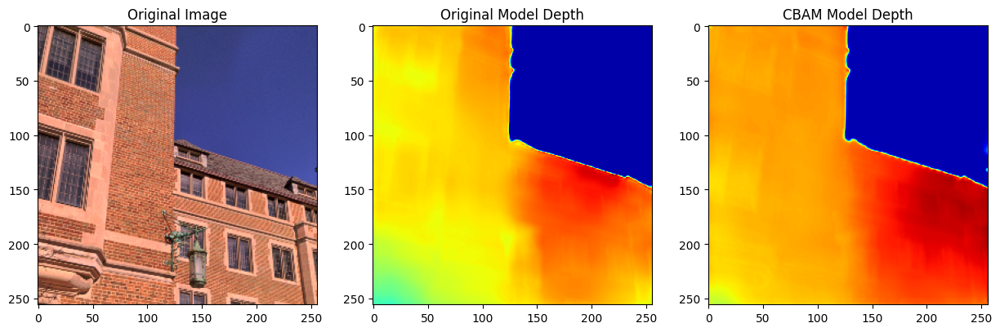

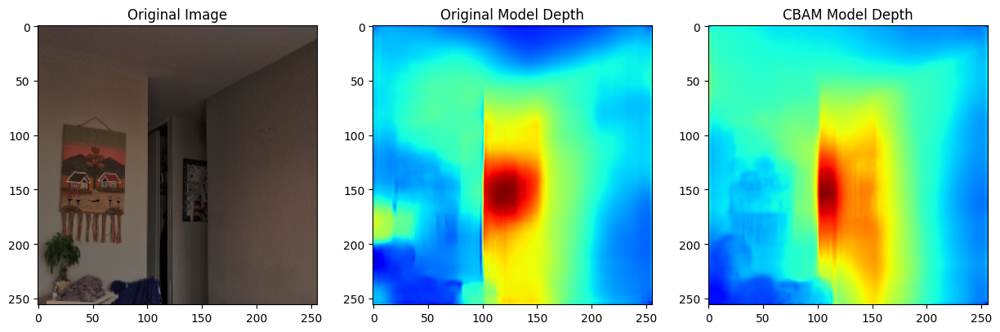

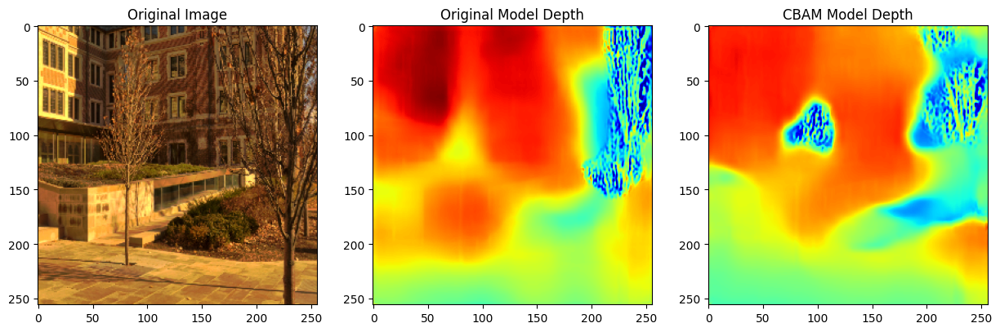

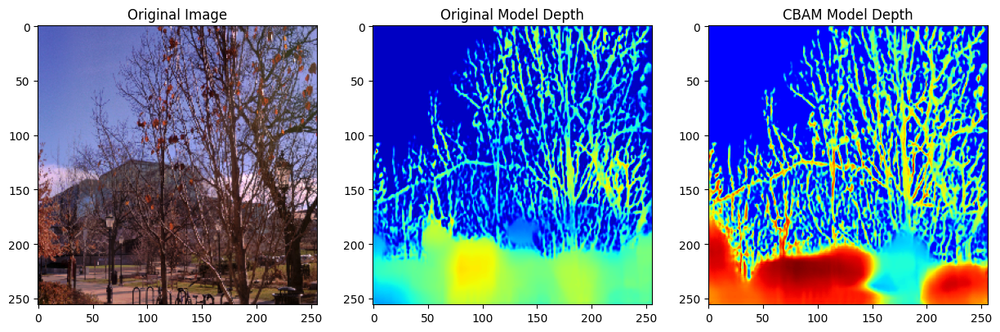

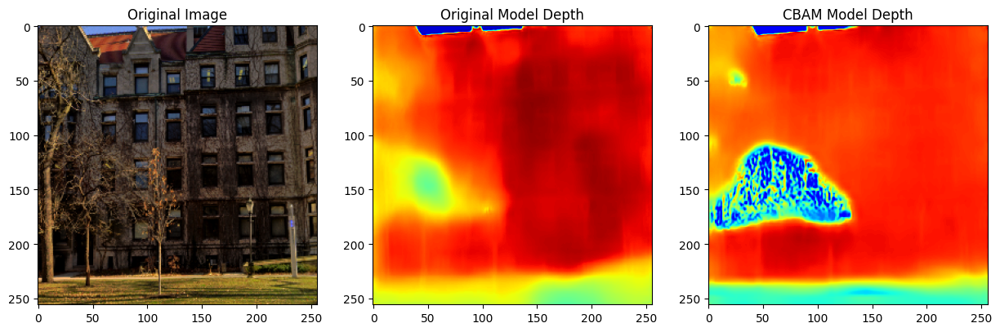

...

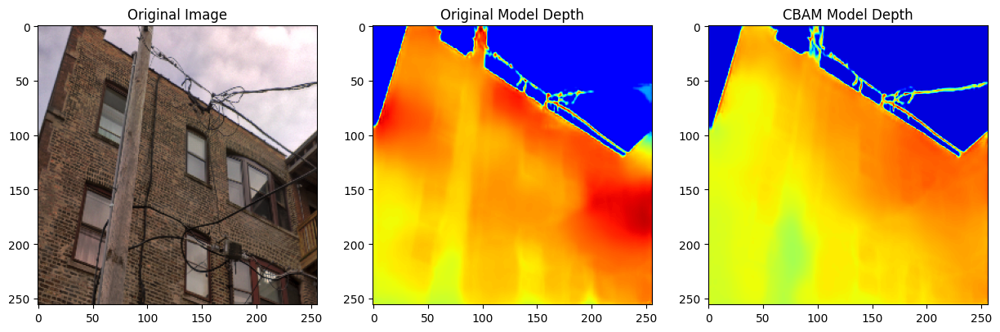

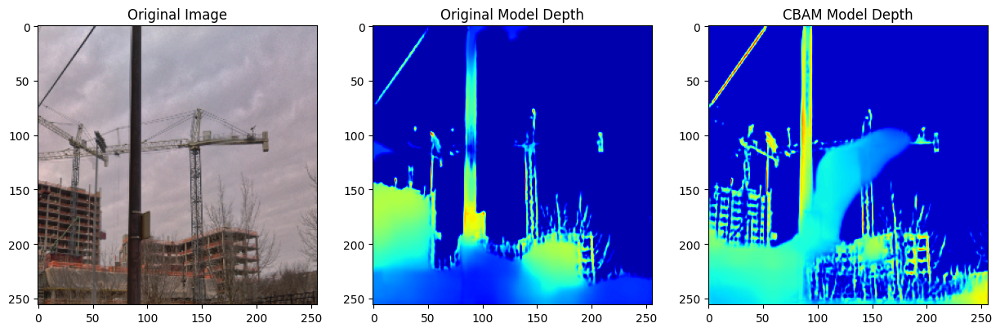

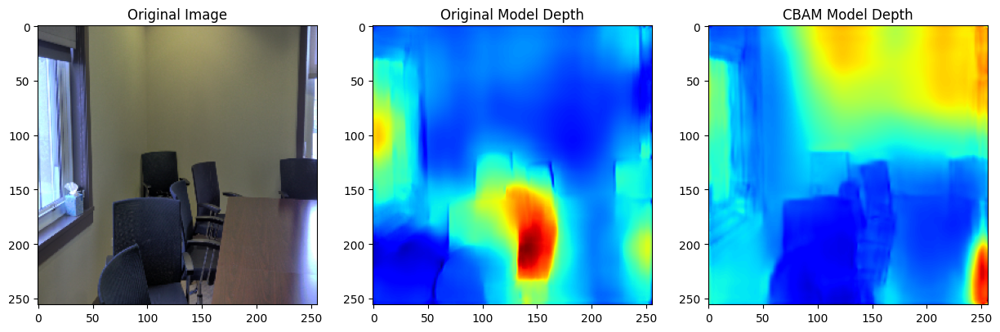

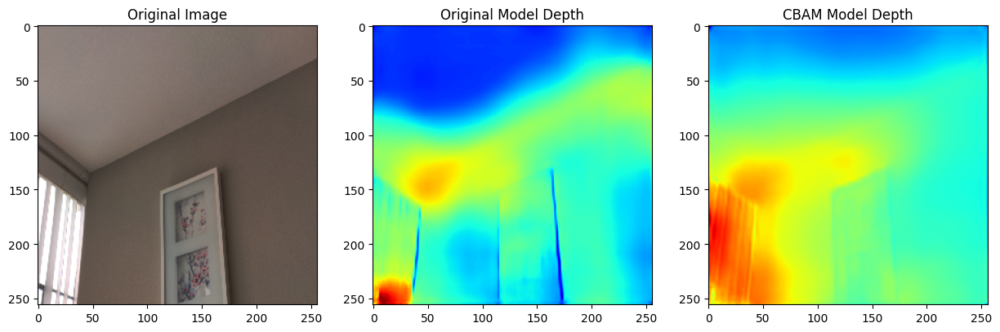

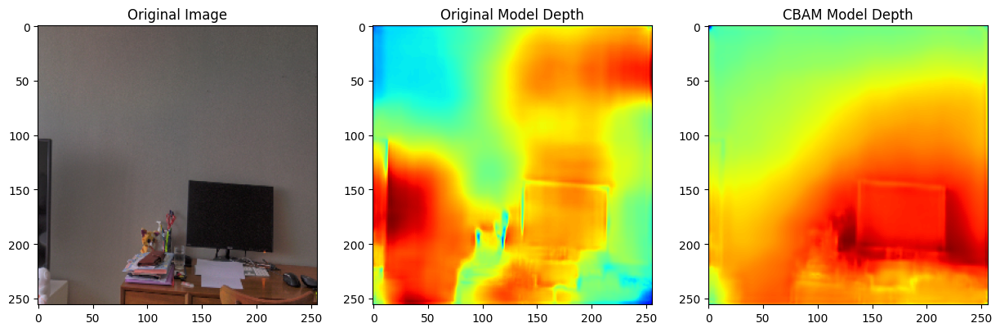

In [32]:
import matplotlib.pyplot as plt
import numpy as np

def compare_errors(original_model, cbam_model, test_images, test_depth_maps):
    """Compares errors between the original and CBAM-based models."""
    original_preds = original_model.predict(test_images)
    cbam_preds = cbam_model.predict(test_images)
    
    original_mae = np.mean(np.abs(original_preds - test_depth_maps))
    cbam_mae = np.mean(np.abs(cbam_preds - test_depth_maps))
    
    print(f"Original Model MAE: {original_mae:.4f}")
    print(f"CBAM Model MAE: {cbam_mae:.4f}")
    
    for i in range(100):
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.imshow(test_images[i])
        plt.title("Original Image")
        
        plt.subplot(1, 3, 2)
        plt.imshow(original_preds[i, :, :, 0], cmap=plt.cm.jet)
        plt.title("Original Model Depth")
        
        plt.subplot(1, 3, 3)
        plt.imshow(cbam_preds[i, :, :, 0], cmap=plt.cm.jet)
        plt.title("CBAM Model Depth")
        plt.show()

# **Running Comparison**
compare_errors(model, model_with_cbam, X_val[:100], y_val[:100])

In [ ]:
# # New Cell: Implementing Channel Attention Mechanism
# from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Multiply, Reshape

# def channel_attention(input_feature, ratio=8):
#     """Applies channel attention mechanism to input feature map."""
#     channel = input_feature.shape[-1]
    
#     # Global Average Pooling
#     shared_layer_one = GlobalAveragePooling2D()(input_feature)
#     shared_layer_one = Reshape((1, 1, channel))(shared_layer_one)
    
#     # Fully Connected Layers
#     shared_layer_two = Dense(channel // ratio, activation='relu', use_bias=False)(shared_layer_one)
#     shared_layer_three = Dense(channel, activation='sigmoid', use_bias=False)(shared_layer_two)
    
#     # Apply attention
#     attention_output = Multiply()([input_feature, shared_layer_three])
#     return attention_output

# # Modify the Model to Include Channel Attention

# def create_depth_estimation_model_with_attention(input_shape=(256, 256, 3)):
#     inputs = Input(shape=input_shape)
#     base_model = ResNet50(weights='imagenet', include_top=False, input_tensor=inputs)
    
#     skip_connections = [
#         base_model.get_layer("conv1_relu").output,
#         base_model.get_layer("conv2_block3_out").output,
#         base_model.get_layer("conv3_block4_out").output,
#         base_model.get_layer("conv4_block6_out").output,
#     ]
    
#     # Apply channel attention to encoder outputs
#     skip_connections = [channel_attention(skip) for skip in skip_connections]
    
#     up1 = UpSampling2D(size=(2, 2))(base_model.output)
#     concat1 = concatenate([up1, skip_connections[3]], axis=-1)
#     conv1 = Conv2D(1024, 3, activation='relu', padding='same')(concat1)
#     conv1 = Conv2D(1024, 3, activation='relu', padding='same')(conv1)
    
#     up2 = UpSampling2D(size=(2, 2))(conv1)
#     concat2 = concatenate([up2, skip_connections[2]], axis=-1)
#     conv2 = Conv2D(512, 3, activation='relu', padding='same')(concat2)
#     conv2 = Conv2D(512, 3, activation='relu', padding='same')(conv2)
    
#     up3 = UpSampling2D(size=(2, 2))(conv2)
#     concat3 = concatenate([up3, skip_connections[1]], axis=-1)
#     conv3 = Conv2D(256, 3, activation='relu', padding='same')(concat3)
#     conv3 = Conv2D(256, 3, activation='relu', padding='same')(conv3)
    
#     up4 = UpSampling2D(size=(2, 2))(conv3)
#     concat4 = concatenate([up4, skip_connections[0]], axis=-1)
#     conv4 = Conv2D(128, 3, activation='relu', padding='same')(concat4)
#     conv4 = Conv2D(128, 3, activation='relu', padding='same')(conv4)
    
#     up5 = UpSampling2D(size=(2, 2))(conv4)
#     conv5 = Conv2D(64, 3, activation='relu', padding='same')(up5)
#     conv5 = Conv2D(64, 3, activation='relu', padding='same')(conv5)
    
#     output = Conv2D(1, 1, activation='linear')(conv5)
#     model = Model(inputs=inputs, outputs=output)
    
#     return model

# # Training with Attention Model
# with tf.device('/GPU:0'):
#     model_with_attention = create_depth_estimation_model_with_attention()
#     model_with_attention.compile(optimizer='adam', loss=custom_loss, metrics=['mae'])
#     history_with_attention = model_with_attention.fit(
#         X_train, y_train, epochs=60, batch_size=32, validation_data=(X_val, y_val), shuffle=True
#     )

# # Final Cell: Error Comparison
# import matplotlib.pyplot as plt
# import numpy as np

# def compare_errors(original_model, attention_model, test_images, test_depth_maps):
#     """Compares errors between the original and attention-based models."""
#     original_preds = original_model.predict(test_images)
#     attention_preds = attention_model.predict(test_images)
    
#     original_mae = np.mean(np.abs(original_preds - test_depth_maps))
#     attention_mae = np.mean(np.abs(attention_preds - test_depth_maps))
    
#     print(f"Original Model MAE: {original_mae:.4f}")
#     print(f"Attention Model MAE: {attention_mae:.4f}")
    
#     for i in range(5):
#         plt.figure(figsize=(15, 5))
#         plt.subplot(1, 3, 1)
#         plt.imshow(test_images[i])
#         plt.title("Original Image")
        
#         plt.subplot(1, 3, 2)
#         plt.imshow(original_preds[i, :, :, 0], cmap=plt.cm.jet)
#         plt.title("Original Model Depth")
        
#         plt.subplot(1, 3, 3)
#         plt.imshow(attention_preds[i, :, :, 0], cmap=plt.cm.jet)
#         plt.title("Attention Model Depth")
#         plt.show()

# # Running comparison
# compare_errors(model, model_with_attention, X_val[:5], y_val[:5])